# Transcription Factor Project - Feature Selection + Minimum Distortion Embedding (MDE) Testing
**Robin Anwyl, UCSD Subramaniam Lab**

**Goal:** Analyze the hiPSC Perturb-seq dataset from the Mali lab (Nourreddine et al 2023 preprint) to investigate the effects of transcription factor knockouts (TF KDs)

**Guiding Questions:** What do TF KD effects reveal about:
* … the transcription regulatory network of hiPSCs, and TF crosstalk?
* … cell lineage?
* … how TFs influence chromatin remodeling?

# Import statements

Using psp_env virtual environment

In [1]:
import sys
import os
psp_root = "/home/ranwyl/KOLF2.1J_Perturbation_Cell_Atlas/"
if psp_root not in sys.path:
    sys.path.insert(0, psp_root)

import psp
import gc
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'

# Number of DEGs for padj < 0.05 vs. padj < 0.1

Feature selection testing (LFC and padj thresholds)

In [ ]:
import pandas as pd

filepath_pkl = "/home/ranwyl/results_tf_project/DE_results_gene_targets_3chunks_ntc_gRNA_reps.pkl"
de_results_df_gene_targets = pd.read_pickle(filepath_pkl)
file_path = "/home/ranwyl/data_tf_project/KOLF_Pan_Genome_Alpha_CPMnorm_NTC_benchmarked.h5ad"
adata = psp.utils.read_anndata(file_path)
adata

AnnData object with n_obs × n_vars = 101538 × 16115
    obs: 'gRNA', 'n_gRNA', 'n_gRNA_UMIs', 'gene_target', 'celltype', 'perturbation_type', 'n_UMI_counts', 'n_genes', 'perturbed', 'channel', 'perturbation', 'gene_target_ensembl_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'gene_target_expression (CPM)', 'NTC_target_gene_expression (CPM)', 'target_knockdown', 'perturbation_edist', 'perturbation_pvalue', 'perturbation_significant'
    var: 'gene_ids', 'feature_types', 'n_UMI_counts', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'etest_results', 'etest_results_params'
    layers: 'counts'

In [3]:
def build_n_cells_degs_df(DE_results_df, adata, target_type="perturbation",
                          alpha=0.05, padj_col="padj"):
    if (target_type != "perturbation") & (target_type != "gene_target"):
        raise ValueError("target_type must be 'perturbation' or 'gene_target")
    # Build DF of targets and n_cells
    n_cells_degs_df = adata.obs[target_type].value_counts().reset_index()
    if "NTC" in n_cells_degs_df[target_type].values:
        n_cells_degs_df = n_cells_degs_df[n_cells_degs_df[target_type] != "NTC"]
    n_cells_degs_df.rename(columns={"count": "n_cells"}, inplace=True)
    n_cells_degs_df.sort_values(by=target_type, inplace=True)
    # Build n_DEGs column
    n_degs_list = list()
    targets = n_cells_degs_df[target_type].tolist()
    for target in targets:
        target_df = \
            DE_results_df.loc[:, DE_results_df.columns.str.contains(f"{target}_")]
        n_degs = len(target_df[target_df[f"{target}_{padj_col}"] < alpha])
        n_degs_list.append(n_degs)
    n_cells_degs_df["n_DEGs"] = n_degs_list
    index_name = target_type if target_type == "gene_target" else "gRNA"
    n_cells_degs_df = n_cells_degs_df.set_index(target_type).rename_axis(index_name)
    return n_cells_degs_df

In [4]:
def build_DE_method_comparison_df(n_cells_degs_df_list, index_list, 
                                  target_type="perturbation"):
    df_dict = dict()
    for i in range(len(n_cells_degs_df_list)):
        n_cells_degs_df = n_cells_degs_df_list[i]
        lt_0_degs = len(n_cells_degs_df[n_cells_degs_df['n_DEGs'] == 0])
        gt_0_degs = len(n_cells_degs_df[n_cells_degs_df['n_DEGs'] > 0])
        gte_3_degs = len(n_cells_degs_df[n_cells_degs_df['n_DEGs'] >= 3])
        gte_10_degs = len(n_cells_degs_df[n_cells_degs_df['n_DEGs'] >= 10])
        df_dict[index_list[i]] = [lt_0_degs, gt_0_degs, gte_3_degs, gte_10_degs]
    target_str = "gRNAs" if target_type == "perturbation" else "KDs"
    cols = [f"{target_str} w/ 0 DEGs", ">0 DEGs", "≥3 DEGs", "≥10 DEGs"]
    de_comparison_df = pd.DataFrame.from_dict(df_dict, orient="index", columns=cols)
    return de_comparison_df

In [7]:
gene_target_n_cells_degs_df5 = \
    build_n_cells_degs_df(de_results_df_gene_targets, adata, 
                          target_type="gene_target", alpha=0.05)
gene_target_n_cells_degs_df10 = \
    build_n_cells_degs_df(de_results_df_gene_targets, adata, 
                          target_type="gene_target", alpha=0.1)

In [8]:
gene_target_n_cells_degs_df5.sort_values(by="n_DEGs")

,n_cells,n_DEGs
gene_target,,
ATF6B,62,0
ATOH1,114,0
BARX1,237,0
BHLHA9,164,0
BHLHE22,216,0
...,...,...
ZNF521,83,611
POU3F2,50,739
PHF20,46,855


In [9]:
gene_target_n_cells_degs_df10.sort_values(by="n_DEGs")

,n_cells,n_DEGs
gene_target,,
ZNF177,69,0
RFX2,214,0
KLF11,173,0
ZNF746,140,0
ZNF836,104,0
...,...,...
ZNF521,83,812
POU3F2,50,966
PHF20,46,1121


For each padj threshold, plot histogram of the number of DEGs per gene target

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_degs_per_kd_histogram(n_cells_degs_df: pd.DataFrame, n_degs_str: str="n_DEGs",
                               min_n_degs: int=0, title: str="", fig_size: tuple=(4,3), 
                               bin_width=50, xtick_width=500, xmax=None):
    plt.figure(figsize=fig_size)
    if xmax is None:
        degs_xmax = max(n_cells_degs_df[n_degs_str].values)
        xmax = ((degs_xmax // bin_width) + 1) * bin_width
    sns.histplot(n_cells_degs_df[n_cells_degs_df[n_degs_str] >= min_n_degs][n_degs_str].values, 
                 binwidth=bin_width, binrange=(0,xmax))
    plt.xlim(0, xmax)
    plt.xticks(np.arange(0, xmax, xtick_width), fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(False)
    plt.title(title)

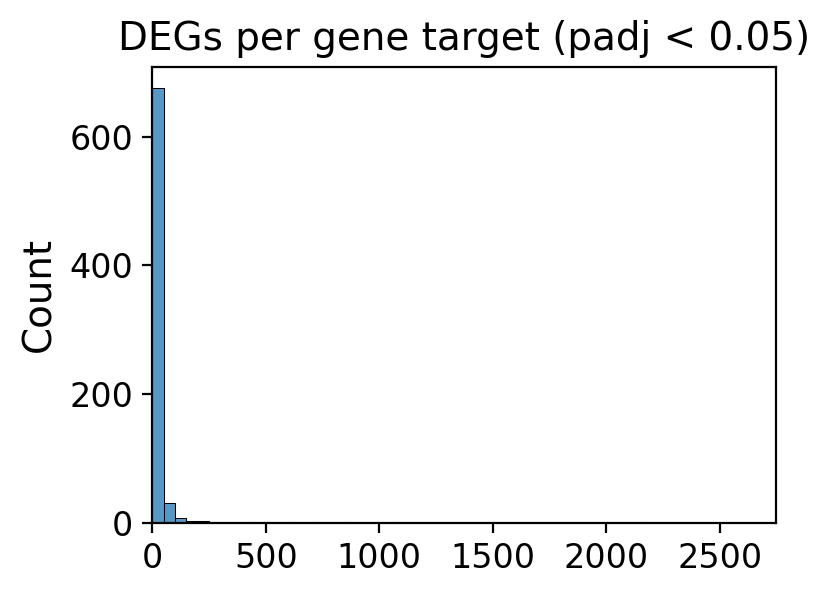

In [13]:
plot_degs_per_kd_histogram(gene_target_n_cells_degs_df5, xmax=2750,
                           title="DEGs per gene target (padj < 0.05)")

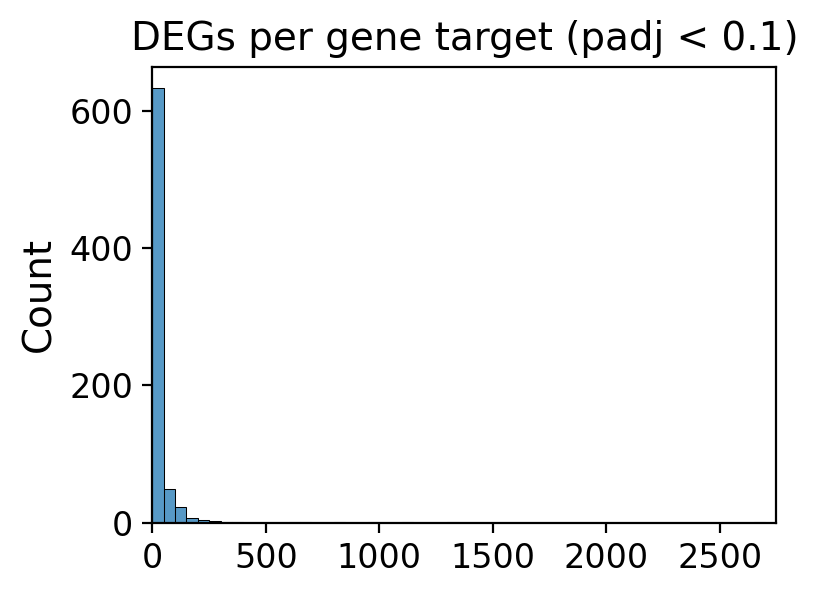

In [14]:
plot_degs_per_kd_histogram(gene_target_n_cells_degs_df10, xmax=2750, 
                           title="DEGs per gene target (padj < 0.1)")

Calculate median and mean DEGs per gene target

In [15]:
def calculate_median_mean_degs_per_gene_target():
    median5 = int(gene_target_n_cells_degs_df5["n_DEGs"].median())
    mean5 = int(gene_target_n_cells_degs_df5["n_DEGs"].mean())
    median10 = int(gene_target_n_cells_degs_df10["n_DEGs"].median())
    mean10 = int(gene_target_n_cells_degs_df10["n_DEGs"].mean())
    print(f"# DEGs per gene target (padj < 0.05): median {median5}, mean {mean5}")
    print(f"# DEGs per gene target (padj < 0.1): median {median10}, mean {mean10}")

In [16]:
calculate_median_mean_degs_per_gene_target()

# DEGs per gene target (padj < 0.05): median 2, mean 20
# DEGs per gene target (padj < 0.1): median 5, mean 30


Compare the 2 padj thresholds by the total number of DEGs for all gene targets

In [18]:
df_list = [gene_target_n_cells_degs_df5, gene_target_n_cells_degs_df10]
df_rows = ["3 chunks, 75 NTC cells per rep, padj < 0.05", 
           "3 chunks, 75 NTC cells per rep, padj < 0.1"]
res_df = \
    build_DE_method_comparison_df(df_list, df_rows, target_type="gene_target")
res_df

,KDs w/ 0 DEGs,>0 DEGs,≥3 DEGs,≥10 DEGs
"3 chunks, 75 NTC cells per rep, padj < 0.05",202,524,352,187
"3 chunks, 75 NTC cells per rep, padj < 0.1",123,603,472,247


In [20]:
def filter_degs_lfc(DE_results_df, lfc_threshold=0.25, padj_threshold=0.05):
    # Get list of perturbations from column labels
    perts = {col.split("_")[0] for col in DE_results_df.columns}
    # Get genes where |L2FC| > threshold and p-adj < threshold
    lfc_degs = set()
    for pert in perts:
        l2fc_col = f"{pert}_log2FoldChange"
        padj_col = f"{pert}_padj"
        lfc_degs.update(DE_results_df.loc[(abs(DE_results_df[l2fc_col]) > lfc_threshold) 
                                   & (DE_results_df[padj_col] < padj_threshold)].index)
    return lfc_degs

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_n_degs_by_lfc_threshold(de_df, padj_threshold=0.05,
                                 lfc_thresholds=[0, 0.1, 0.2, 0.25, 0.3, 0.4, 0.5, 
                                                 0.6, 0.7, 0.75, 0.8, 0.9, 1],
                                 title="# DEGs"):
    n_degs_list = list()
    for lfc_thr in lfc_thresholds:
        lfc_degs = filter_degs_lfc(de_df, padj_threshold=padj_threshold, 
                                   lfc_threshold=lfc_thr)
        n_degs_list.append(len(lfc_degs))
    lfc_degs_df = pd.DataFrame.from_dict({"lfc": lfc_thresholds, "n_degs": n_degs_list})
    ax = sns.barplot(lfc_degs_df, x="lfc", y="n_degs")
    ax.set_xlabel("LFC Threshold")
    ax.set_ylabel("# DEGs")
    ax.set_title(title)
    ax.bar_label(ax.containers[0], fontsize=11)
    ax.grid(False)
    plt.show()

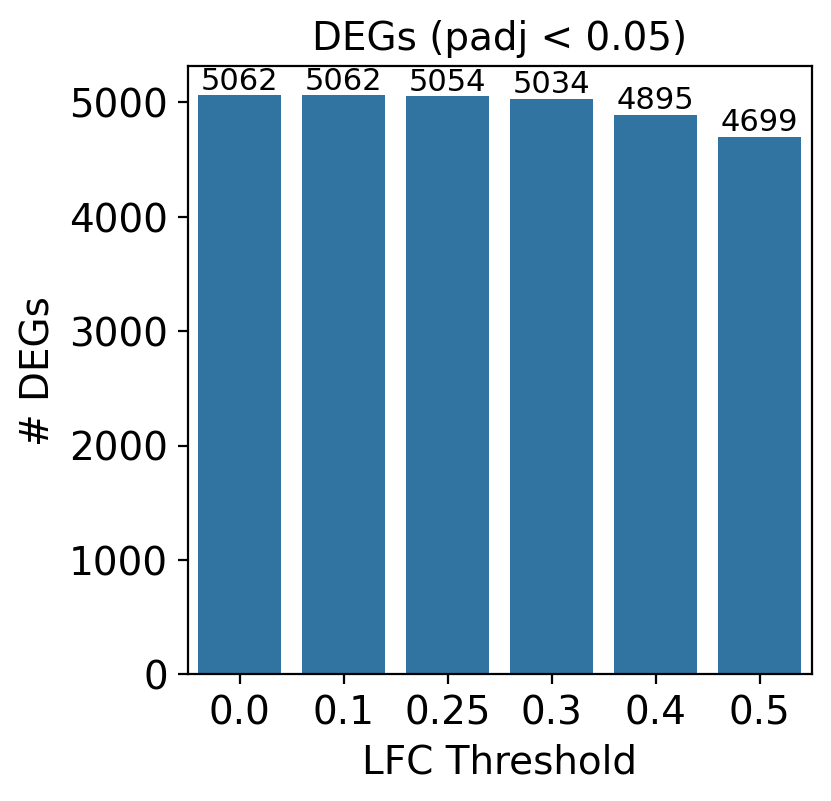

In [21]:
plot_n_degs_by_lfc_threshold(de_results, 
                             padj_threshold=0.05,
                             lfc_thresholds=[0, 0.1, 0.25, 0.3, 0.4, 0.5],
                             title="DEGs (padj < 0.05)")

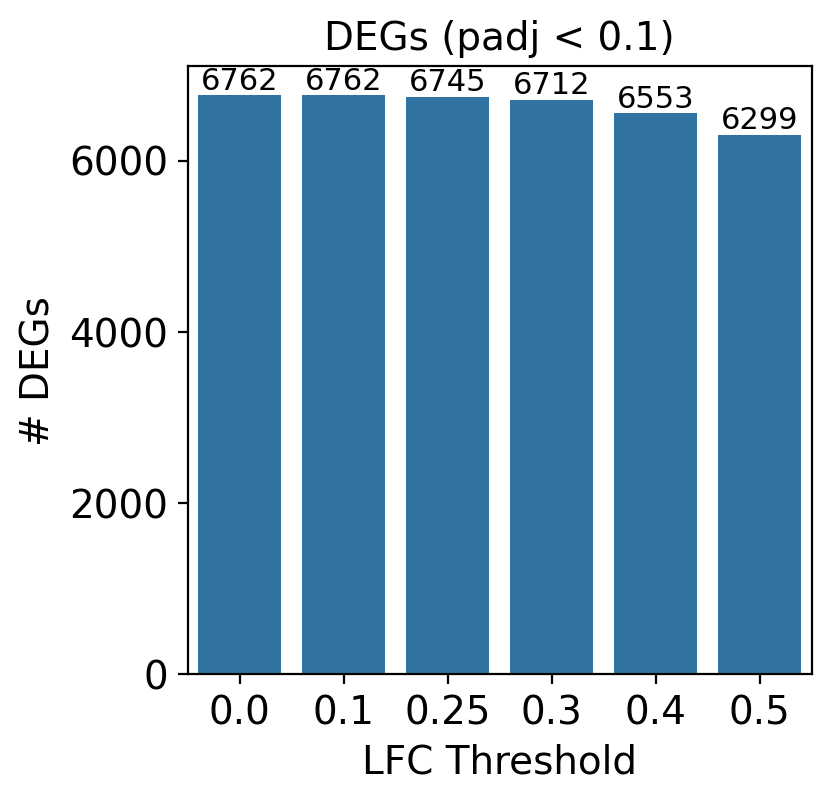

In [22]:
plot_n_degs_by_lfc_threshold(de_results_df_gene_targets, 
                             padj_threshold=0.1,
                             lfc_thresholds=[0, 0.1, 0.25, 0.3, 0.4, 0.5],
                             title="DEGs (padj < 0.1)")

Create subsets of normalized adata with only TF KD cells and these padj/LFC thresholds:
-  padj < 0.05, |LFC| > 0.25
-  padj < 0.1, |LFC| > 0.25
-  padj < 0.05, |LFC| > 0.5
-  padj < 0.1, |LFC| > 0.5

In [ ]:
filepath = "/home/ranwyl/data_tf_project/KOLF_Pan_Genome_Alpha_norm_for_embedding_analysis.h5ad"
adata_norm = psp.utils.read_anndata(filepath)

In [ ]:
def filter_degs_lfc(DE_results_df, lfc_threshold=0.25, padj_threshold=0.05):
    # Get list of perturbations from column labels
    perts = {col.split("_")[0] for col in DE_results_df.columns}
    # Get genes where |L2FC| > threshold and p-adj < threshold
    lfc_degs = set()
    for pert in perts:
        l2fc_col = f"{pert}_log2FoldChange"
        padj_col = f"{pert}_padj"
        lfc_degs.update(DE_results_df.loc[(abs(DE_results_df[l2fc_col]) > lfc_threshold) 
                                   & (DE_results_df[padj_col] < padj_threshold)].index)
    return lfc_degs

def filter_adata_tf_kds_degs(adata, DE_results_df, lfc_threshold, padj_threshold):
    degs = filter_degs_lfc(DE_results_df, lfc_threshold, padj_threshold)
    adata_filt = adata[adata.obs.perturbed == "True"]
    adata_filt = adata_filt[:, adata_filt.var.index.isin(degs)]
    return adata_filt.copy()

In [ ]:
adata_padj5_lfc0pt25 = filter_adata_tf_kds_degs(adata_norm, de_results, 
                                                lfc_threshold=0.25, padj_threshold=0.05)

In [ ]:
filename = "/home/ranwyl/data_tf_project/KOLF_Pan_Genome_Alpha_norm_for_analysis_padj5_lfc0pt25.h5ad"
adata_padj5_lfc0pt25.write_h5ad(filename)

In [ ]:
adata_padj5_lfc0pt5 = filter_adata_tf_kds_degs(adata_norm, de_results, 
                                                lfc_threshold=0.5, padj_threshold=0.05)
adata_padj10_lfc0pt25 = filter_adata_tf_kds_degs(adata_norm, de_results, 
                                                lfc_threshold=0.25, padj_threshold=0.1)
adata_padj10_lfc0pt5 = filter_adata_tf_kds_degs(adata_norm, de_results, 
                                                lfc_threshold=0.5, padj_threshold=0.1)

In [ ]:
for a in [adata_padj5_lfc0pt25, adata_padj5_lfc0pt5, adata_padj10_lfc0pt25, adata_padj10_lfc0pt5]:
    print(a.n_vars)

5054
4699
6745
6299


## Pairwise Pearson correlation matrix

In [ ]:
import numpy as np
import pandas as pd
from tqdm_joblib import tqdm_joblib
from joblib import Parallel, parallel_backend, delayed
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from contextlib import contextmanager

# Handle warnings
@contextmanager
def handle_warnings(suppress):
    if suppress:
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            yield
    else:
        yield

def compute_mean_profile(adata, group_indices):
    mean_vector = adata[group_indices, :].X.mean(axis=0)
    return mean_vector.A1 if hasattr(mean_vector, 'A1') else mean_vector

# Modified from GitHub code to take n_jobs and figsize as arguments
# and suppress warning about clustering with Seaborn being slow
def create_corrmatrix(adata, title='', mode='perturb', 
                      vmax=None, vmin=None, n_jobs=20, 
                      figsize=(8,8), suppress_warnings=True):
    gene_target_groups = adata.obs.groupby('gene_target').indices
        # Initialize tqdm progress bar
    with tqdm_joblib(desc="Computing mean profiles", total=len(gene_target_groups)) as progress_bar:
        # Compute the mean expression profile for each group in parallel
        with parallel_backend('threading'):
            mean_profiles = Parallel(n_jobs=n_jobs)(
                delayed(compute_mean_profile)(adata, indices) 
                for indices in gene_target_groups.values()
            )
    mean_profiles = pd.DataFrame(np.array(mean_profiles).T,index=list(adata.var.index),columns=list(gene_target_groups.keys()))
    if mode == 'perturb':
        corr_matrix = np.corrcoef(mean_profiles.T)
        distance_df = pd.DataFrame(corr_matrix, index=mean_profiles.columns, columns=mean_profiles.columns)
    elif mode == 'gene':
        corr_matrix = np.corrcoef(mean_profiles)
        distance_df = pd.DataFrame(corr_matrix, index=mean_profiles.index, columns=mean_profiles.index)
    lim = np.percentile(abs(corr_matrix.flatten()), 98)
    if vmax is None:
        vmax = lim
    if vmin is None:
        vmin = -lim
    with handle_warnings(suppress_warnings):
        fig = sns.clustermap(distance_df,cmap="RdBu",xticklabels=False, yticklabels=False, center=0, 
            vmax=vmax, vmin=vmin, figsize=figsize)
    fig.ax_heatmap.set_xlabel('')
    fig.ax_heatmap.set_ylabel('');
    fig.ax_heatmap.set_title(title)
    fig.ax_row_dendrogram.set_visible(False)
    fig.ax_col_dendrogram.set_visible(False)
    return(fig,distance_df,mean_profiles)

In [ ]:
fig, perturb_corrs, mp = \
    create_corrmatrix(adata_padj5_lfc0pt25, mode="perturb", figsize=(6,6), vmax=0.2, vmin=-0.2, 
                      title="Perturbation Correlations (padj < 0.05, |LFC| > 0.25)")

In [ ]:
fig, perturb_corrs, mp = \
    create_corrmatrix(adata_padj5_lfc0pt5, mode="perturb", figsize=(6,6), vmax=0.2, vmin=-0.2,
                      title="Perturbation Correlations (padj < 0.05, |LFC| > 0.5)")

In [ ]:
fig, perturb_corrs, mp = \
    create_corrmatrix(adata_padj10_lfc0pt25, mode="perturb", vmax=0.2, vmin=-0.2, figsize=(6,6),
                      title="Perturbation Correlations (padj < 0.1, |LFC| > 0.25)")

In [ ]:
fig, perturb_corrs, mp = \
    create_corrmatrix(adata_padj10_lfc0pt5, mode="perturb", vmax=0.2, vmin=-0.2, figsize=(6,6),
                      title="Perturbation Correlations (padj < 0.1, |LFC| > 0.5)")

In [ ]:
fig, gene_corrs, mp = \
    create_corrmatrix(adata_padj5_lfc0pt25, mode="gene", figsize=(6,6), vmax=0.2, vmin=-0.2,
                      title="Gene Correlations (padj < 0.05, |LFC| > 0.25)")

In [ ]:
fig, gene_corrs, mp = \
    create_corrmatrix(adata_padj5_lfc0pt5, mode="gene", figsize=(6,6), vmax=0.2, vmin=-0.2,
                      title="Gene Correlations (padj < 0.05, |LFC| > 0.5)")

In [ ]:
fig, gene_corrs, mp = \
    create_corrmatrix(adata_padj10_lfc0pt25, mode="gene", figsize=(6,6), vmax=0.2, vmin=-0.2,
                      title="Gene Correlations (padj < 0.1, |LFC| > 0.25)")

In [ ]:
fig, gene_corrs, mp = \
    create_corrmatrix(adata_padj10_lfc0pt5, mode="gene", figsize=(6,6), vmax=0.2, vmin=-0.2,
                      title="Gene Correlations (padj < 0.1, |LFC| > 0.5)")

## Minimum Distortion Embedding

Generate MDE for both |LFC| > 0.25 conditions (padj < 0.05 and padj < 0.1)

In [ ]:
import anndata as ad
import numpy as np
import pandas as pd
import pymde
from sklearn.manifold import SpectralEmbedding
from sklearn.neighbors import kneighbors_graph
from sklearn.metrics import silhouette_score
import igraph as ig
from scipy.spatial.distance import pdist, squareform
import leidenalg
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

def compute_mean_normalized_profile(adata, group_indices):
    mean_vector = adata[group_indices, :].X.mean(axis=0)
    normalized_mean_vector = (mean_vector - np.mean(mean_vector)) / np.std(mean_vector)
    return normalized_mean_vector.A1 if hasattr(normalized_mean_vector, 'A1') else normalized_mean_vector

def compute_MDE(adata: ad.AnnData, 
                random_state: int = 42,
                # MDE parameters
                preserve: str = "neighbors",
                spectral: bool = True,
                n_components: int = 30,
                mde_repulsive_fraction: float = 0.15,
                mde_n_neighbors: int = 15,
                spectral_n_neighbors: int = 10,
                # Clustering parameters
                knn_n_neighbors: int = 5,
                leiden_resolution: float = 1.0,
                # Visualization parameters
                label_points: bool = False,
                title: str = ""):
    adata = adata.copy()
    gene_target_groups = adata.obs.groupby('gene_target').indices

    # Compute mean normalized profiles
    mean_profiles = [compute_mean_normalized_profile(adata, indices) 
                     for indices in gene_target_groups.values()]
    mean_profiles_array = np.array(mean_profiles)

    # Compute MDE
    pymde.seed(random_state)
    mde = None
    embedding = None
    if preserve == "neighbors":
        if spectral:
            spectral_embedding = SpectralEmbedding(
                n_components=n_components,
                affinity='nearest_neighbors',
                n_neighbors=spectral_n_neighbors,
                eigen_solver='arpack',
                random_state=random_state
            )
            initial_embedding = spectral_embedding.fit_transform(mean_profiles_array)
            mde = pymde.preserve_neighbors(initial_embedding, 
                                           repulsive_fraction=mde_repulsive_fraction, 
                                           n_neighbors=mde_n_neighbors)
            embedding = mde.embed(max_iter=2000,print_every=100,verbose=True)
        else:
            mde = pymde.preserve_neighbors(mean_profiles_array, 
                                           repulsive_fraction=mde_repulsive_fraction, 
                                           n_neighbors=mde_n_neighbors)
            embedding = mde.embed(max_iter=4000,print_every=100,verbose=True)
    else:
        mde = pymde.preserve_distances(mean_profiles_array)
        embedding = mde.embed(
            max_iter=4000 if spectral else 2000,
            print_every=100,
            verbose=True,
            random_state=random_state
            ) # From GitHub

    # Run Leiden clustering on the embeddings
    knn_graph = kneighbors_graph(embedding, n_neighbors=knn_n_neighbors, include_self=False)
    sources, targets = knn_graph.nonzero()
    g = ig.Graph(directed=False)
    g.add_vertices(embedding.shape[0])
    g.add_edges(zip(sources, targets))
    partition = leidenalg.find_partition(
        g,
        leidenalg.RBConfigurationVertexPartition,
        resolution_parameter=leiden_resolution,
        seed=random_state
    )
    
    # Get cluster labels and make pairwise correlation plot
    clusters = np.array(partition.membership)
    gene_targets = list(gene_target_groups.keys())
    embedding_df = pd.DataFrame(embedding, columns=['x', 'y'])
    embedding_df['gene_target'] = gene_targets
    embedding_df['cluster'] = clusters
    embedding_df['cluster'] = embedding_df['cluster'].astype(str)
    cluster_groups = embedding_df.groupby('cluster')
    centroids = cluster_groups[['x', 'y']].mean()
    pairwise_distances = pd.DataFrame(
        squareform(pdist(centroids, metric='euclidean')),
        index=centroids.index,
        columns=centroids.index
    )
    sns.set_style("white")
    sns.clustermap(pairwise_distances, cmap='PuBuGn')
    plt.title('Pairwise Distance Matrix of Cluster Centroids')
    plt.show()

    # Plot using Plotly with Pastel colormap for discrete clusters
    leiden_categories = sorted(embedding_df['cluster'].unique(), key=lambda x: int(x))
    fig = px.scatter(embedding_df, x='x', y='y', text='gene_target', color='cluster',
                     category_orders={'cluster': leiden_categories},
                     hover_data={'x': True, 'y': True, 'gene_target': True},
                     title=title,
                     color_discrete_sequence=px.colors.qualitative.Dark24)
    fig.update_traces(marker=dict(size=7, opacity=0.7),
                      textposition='middle center', textfont=dict(size=4))
    
    fig.update_layout(
        showlegend=True,
        xaxis=dict(visible=False),
        yaxis=dict(visible=False),
        plot_bgcolor='white',
        width=1000,
        height=800,
        legend_title_text='Cluster',
        coloraxis_showscale=False
    )
    if not label_points:
        fig.update_traces(text=None)
   
    fig.show()

    return adata, embedding, clusters, mean_profiles_array, embedding_df, pairwise_distances

def compute_silhouette_score(embedding, clusters, random_state=42):
    return silhouette_score(X=embedding, labels=clusters, random_state=random_state)

def compute_mean_median_pairwise_centroid_distance(pairwise_distances):
    # Extract unique distances (upper triangle only)
    vals = pairwise_distances.values
    upper = vals[np.triu_indices_from(vals, k=1)]
    # Calculate mean and median distance
    mean_dist = upper.mean()
    median_dist = np.median(upper)
    print(f"Mean pairwise cluster centroid distance: {mean_dist}")
    print(f"Median pairwise cluster centroid distance: {median_dist}")
    return mean_dist, median_dist

def gene_targets_per_cluster(embedding_df):
    """
    Return DataFrame where each column contains the perturbations in a cluster.
    """
    cluster_nums = max([int(n) for n in set(embedding_df["cluster"].tolist())])
    cluster_dict = dict()
    for i in range(cluster_nums+1):
        cluster = embedding_df[embedding_df["cluster"] == str(i)]["gene_target"].tolist()
        cluster_dict[i] = cluster
    # Pad all columns to be the same length
    max_n_perts = max(len(cluster_dict[i]) for i in range(len(cluster_dict)))
    cluster_dict = {cluster:(perts + [""]*(max_n_perts-len(perts))) 
                    for cluster, perts in cluster_dict.items()}
    perts_in_cluster_df = pd.DataFrame(cluster_dict)
    return perts_in_cluster_df

def plot_n_perts_per_cluster(perts_in_cluster_df, title, figsize=(6,3), ymax=None):
    sns.set_style("whitegrid")
    n_perts_per_cluster = perts_in_cluster_df.nunique().tolist()
    xvals = [i for i in range(len(n_perts_per_cluster))]
    fig, ax = plt.subplots(figsize=figsize)
    sns.barplot(x=xvals, y=n_perts_per_cluster, ax=ax)
    ax.set_xlabel("Leiden cluster")
    ax.set_ylabel("# TF KDs in cluster")
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)
    if ymax:
        ax.set_ylim(0, ymax)
    ax.set_title(title)

Default MDE settings:
-  preserve: MDE preservation method ('neighbors' or 'distances'), default: 'neighbors'
-  spectral: Whether to use spectral embedding initialization, default: True
-  n_components: Dimension for spectral embedding initialization, default: 30
-  mde_repulsive_fraction: Ratio of repulsive edges in MDE, default: 0.15
-  mde_n_neighbors: Number of neighbors for MDE preservation, default: 15
-  spectral_n_neighbors: Number of neighbors for spectral embedding, default: 15
-  leiden_resolution: Resolution parameter for Leiden clustering, default: 1.0
-  knn_n_neighbors: Number of neighbors for KNN graph construction, default: 5 (called leiden_neighbors in example notebook)

Settings used in example notebook:
-  n_components=20
-  spectral_n_neighbors=25
-  mde_repulsive_fraction=10
-  mde_n_neighbors=7

Will use the default and example notebook settings, except set leiden_neighbors to higher number (for fewer clusters) since there are fewer TF KDs

In [ ]:
filepath = "/home/ranwyl/data_tf_project/KOLF_Pan_Genome_Alpha_norm_for_analysis_padj5_lfc0pt25.h5ad"
adata_padj5_lfc0pt25 = psp.utils.read_anndata(filepath)
adata_padj5_lfc0pt25

AnnData object with n_obs × n_vars = 88249 × 5054
    obs: 'gRNA', 'n_gRNA', 'n_gRNA_UMIs', 'gene_target', 'celltype', 'perturbation_type', 'n_UMI_counts', 'n_genes', 'perturbed', 'channel', 'perturbation', 'gene_target_ensembl_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'gene_target_expression (CPM)', 'NTC_target_gene_expression (CPM)', 'target_knockdown', 'perturbation_edist', 'perturbation_pvalue', 'perturbation_significant', 'batch'
    var: 'gene_ids', 'feature_types', 'n_UMI_counts', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'etest_results', 'etest_results_params'
    layers: 'counts', 'pre_z_

Dec 05 07:51:02 PM: Fitting a centered embedding into R^2, for a graph with 726 items and 100158 edges.
Dec 05 07:51:02 PM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 05 07:51:02 PM: iteration 0000 | distortion 1.312233 | residual norm 0.179808 | step length 1.00352 | percent change 0.473535
Dec 05 07:51:05 PM: iteration 0100 | distortion 0.186391 | residual norm 0.000130988 | step length 1 | percent change 0.603554
Dec 05 07:51:07 PM: iteration 0200 | distortion 0.184287 | residual norm 0.000154994 | step length 1 | percent change 0.237238
Dec 05 07:51:10 PM: iteration 0300 | distortion 0.183151 | residual norm 8.86547e-05 | step length 1 | percent change 0.649477
Dec 05 07:51:12 PM: iteration 0400 | distortion 0.181867 | residual norm 0.000150194 | step length 1 | percent change 0.615927
Dec 05 07:51:15 PM: iteration 0500 | distortion 0.181340 | residual norm 3.99972e-05 | step length 1 | percent change 0.0323382
Dec 05 07:51:16 PM: Converged in 557 ite

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



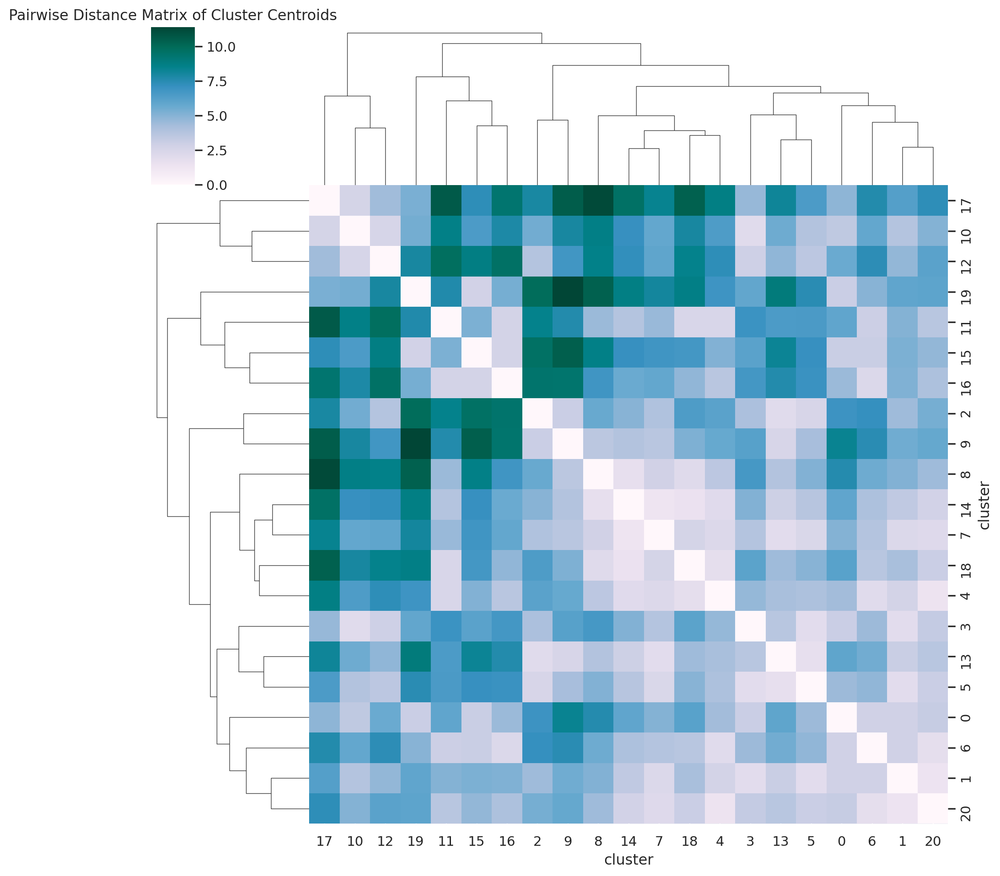

In [ ]:
mde_padj5 = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=5, mde_repulsive_fraction=10, knn_n_neighbors=10)

In [ ]:
_, _, _, _, embedding_df = mde_padj5
perts_in_cluster = gene_targets_per_cluster(embedding_df)
perts_in_cluster.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,ATF1,ATOH1,CAMTA2,ATF3,ANKZF1,ALX4,BAZ2A,ARNT2,BARHL1,CREBZF,...,ADNP2,ASCL5,ATOH8,AHR,DR1,ARHGAP35,ARID3B,DLX1,ASCL1,GATAD2B
1,BHLHA9,BCL11A,DACH2,BACH1,ATF4,BHLHA15,CDX1,ARX,CREB3L4,E2F1,...,ATF6B,BARX1,BHLHE40,ATOH7,DRAP1,ARID2,GLI2,DUXA,CBX2,MSX2
2,CC2D1A,CREB3L1,DMRTB1,BATF,CENPT,DPF3,DEAF1,BHLHE41,CREBL2,ESR1,...,ATMIN,BBX,ERG,BCL6B,EMX1,DLX4,HEY2,EGR1,HNF4A,NFATC3
3,CENPB,CREB3L3,FOXE1,DMRTA1,CENPX,EGR2,DLX2,CTCFL,DMRT1,ETV2,...,BSX,BHLHE22,GATA6,ESR2,ETS1,DOT1L,HMX3,KLF5,MEOX2,OSR2
4,CREB1,DMBX1,FOXI3,E2F2,DMRT2,ELF5,ETS2,ERF,EN1,FOXL1,...,CHAMP1,EBF2,HIF3A,GTF2IRD2,ETV3L,GTF3A,KLF1,LYL1,PHF20,RORC


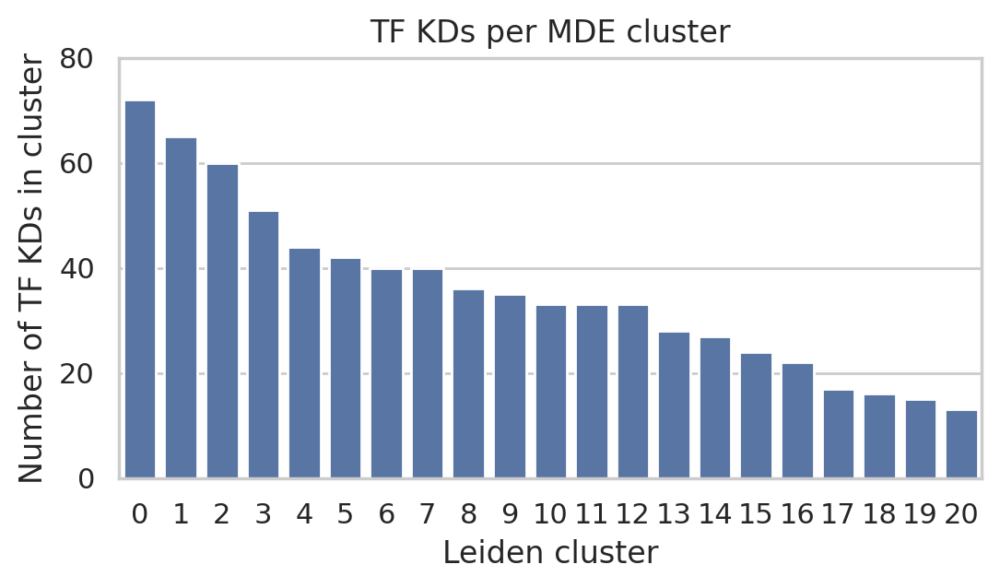

In [ ]:
sns.set_style("whitegrid")
plot_n_perts_per_cluster(perts_in_cluster, title="TF KDs per MDE cluster", ymax=80)

In [ ]:
perts_in_cluster.to_csv("/home/ranwyl/results_tf_project/tf_kd_clusters_12-5-25.csv")

Dec 12 09:11:25 AM: Fitting a centered embedding into R^2, for a graph with 726 items and 47020 edges.
Dec 12 09:11:25 AM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 12 09:11:25 AM: iteration 0000 | distortion 2.193861 | residual norm 0.724971 | step length 0.0461945 | percent change 0.0878875
Dec 12 09:11:26 AM: iteration 0100 | distortion 0.157413 | residual norm 0.000282532 | step length 1 | percent change 0.42995
Dec 12 09:11:27 AM: iteration 0200 | distortion 0.154090 | residual norm 0.000125286 | step length 1 | percent change 0.0848489
Dec 12 09:11:28 AM: iteration 0300 | distortion 0.153317 | residual norm 0.000132018 | step length 1 | percent change 0.271556
Dec 12 09:11:29 AM: iteration 0400 | distortion 0.152364 | residual norm 7.52222e-05 | step length 1 | percent change 0.160824
Dec 12 09:11:30 AM: iteration 0500 | distortion 0.152028 | residual norm 5.99528e-05 | step length 1 | percent change 0.238899
Dec 12 09:11:30 AM: iteration 0600 | di

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



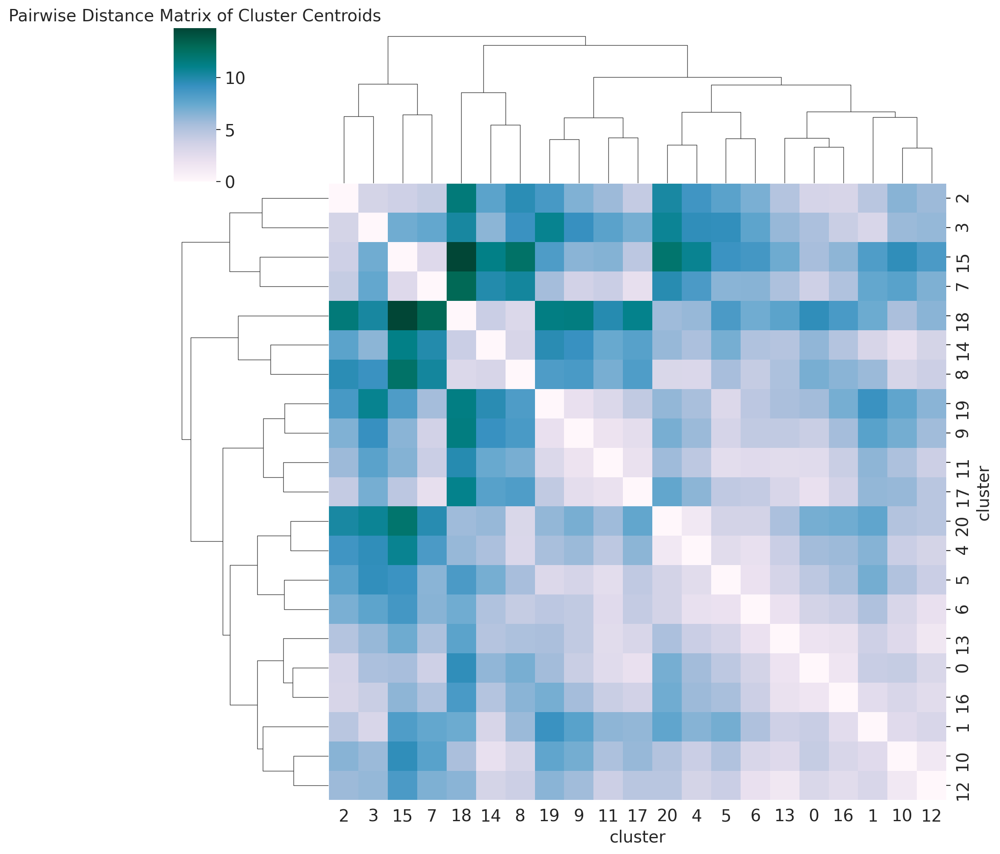

In [ ]:
mde_12nbrs = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=7, mde_repulsive_fraction=10, knn_n_neighbors=12)

In [ ]:
adata12, embedding12, clusters12, mean_profiles_arr12, embedding_df12, pairwise_dists12 = mde_12nbrs
perts_in_cluster12 = gene_targets_per_cluster(embedding_df12)
perts_in_cluster12.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,ARNT2,ATF3,AHR,ARID2,BARHL1,ATOH8,ASCL1,BSX,ATF4,BHLHA15,...,CREB3L3,ATF1,BCL11A,ARX,ADNP2,ANKZF1,ATF6B,ARID3B,DLX1,ASCL5
1,ATOH1,BAZ2A,ATOH7,CENPB,CREB3L4,CAMTA2,DACH2,EBF2,BARX1,CREBZF,...,EGR2,BACH1,DMBX1,BHLHA9,ARHGAP35,HMBOX1,CENPT,ESRRB,DUXA,BHLHE40
2,BATF,BHLHE22,DMRTB1,DLX4,DMRT3,FOXJ1,ELF3,EPAS1,BBX,EN1,...,ELF5,DEAF1,EOMES,CREB3L1,ATMIN,IRX3,DMRT1,GLI2,EGR1,ERG
3,BCL6B,CREB1,DPF3,DOT1L,E2F7,GLI1,ESRRG,ESR1,CBX2,FOXC2,...,FOXA2,DMRTA1,GATAD2A,DBX2,CHAMP1,MEOX1,ETV6,HEY2,ETV2,PAX3
4,CC2D1A,DLX2,ESR2,DR1,ELF4,GLI4,FOXE1,FOXA1,CDX1,FOXE3,...,GRHL1,E2F2,HES3,DMRTC2,DNMT1,MSC,GATA5,HMX3,GMEB1,POU4F2


In [ ]:
silh_score12 = compute_silhouette_score(embedding12, clusters12)
print(silh_score12)

0.32142526


In [ ]:
mean_dist12, median_dist12 = \
    compute_mean_median_pairwise_centroid_distance(pairwise_dists12)

Mean pairwise cluster centroid distance: 5.788494288319084
Median pairwise cluster centroid distance: 5.567595719083922


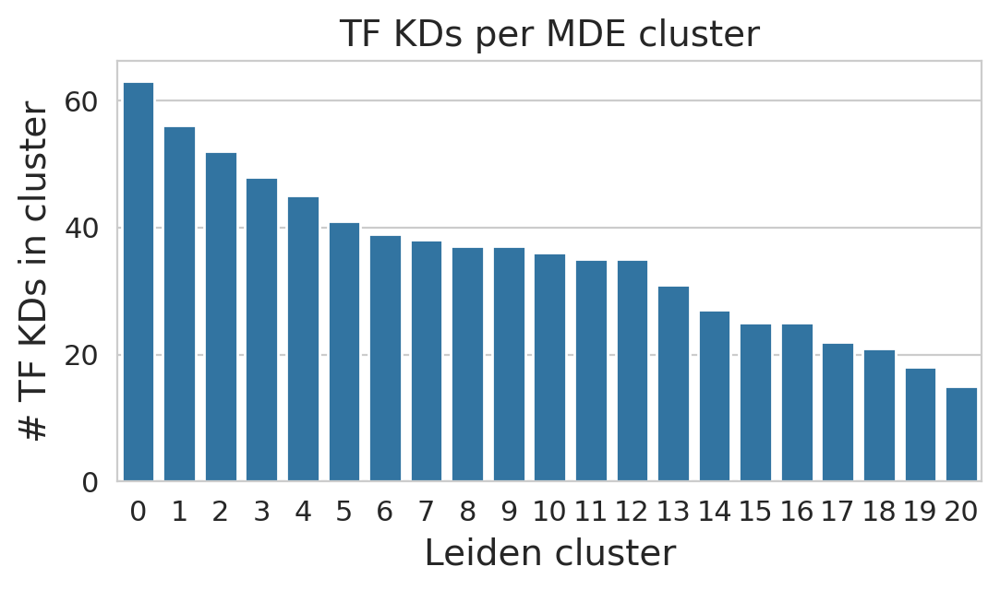

In [ ]:
plot_n_perts_per_cluster(perts_in_cluster12, title="TF KDs per MDE cluster")

In [ ]:
perts_in_cluster12.to_csv("/home/ranwyl/results_tf_project/tf_kd_clusters_12-8-25.csv")

Dec 08 11:52:09 PM: Fitting a centered embedding into R^2, for a graph with 726 items and 33656 edges.
Dec 08 11:52:09 PM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 08 11:52:09 PM: iteration 0000 | distortion 2.804580 | residual norm 1.87417 | step length 0.0183307 | percent change 0.0901583
Dec 08 11:52:10 PM: iteration 0100 | distortion 0.143501 | residual norm 0.0003732 | step length 1 | percent change 1.42743
Dec 08 11:52:10 PM: iteration 0200 | distortion 0.140036 | residual norm 0.000271371 | step length 1 | percent change 0.776039
Dec 08 11:52:11 PM: iteration 0300 | distortion 0.137874 | residual norm 0.000143677 | step length 1 | percent change 0.301216
Dec 08 11:52:12 PM: iteration 0400 | distortion 0.137429 | residual norm 6.63758e-05 | step length 1 | percent change 0.0603065
Dec 08 11:52:13 PM: iteration 0500 | distortion 0.137356 | residual norm 4.94569e-05 | step length 1 | percent change 0.0490207
Dec 08 11:52:14 PM: iteration 0600 | dist

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



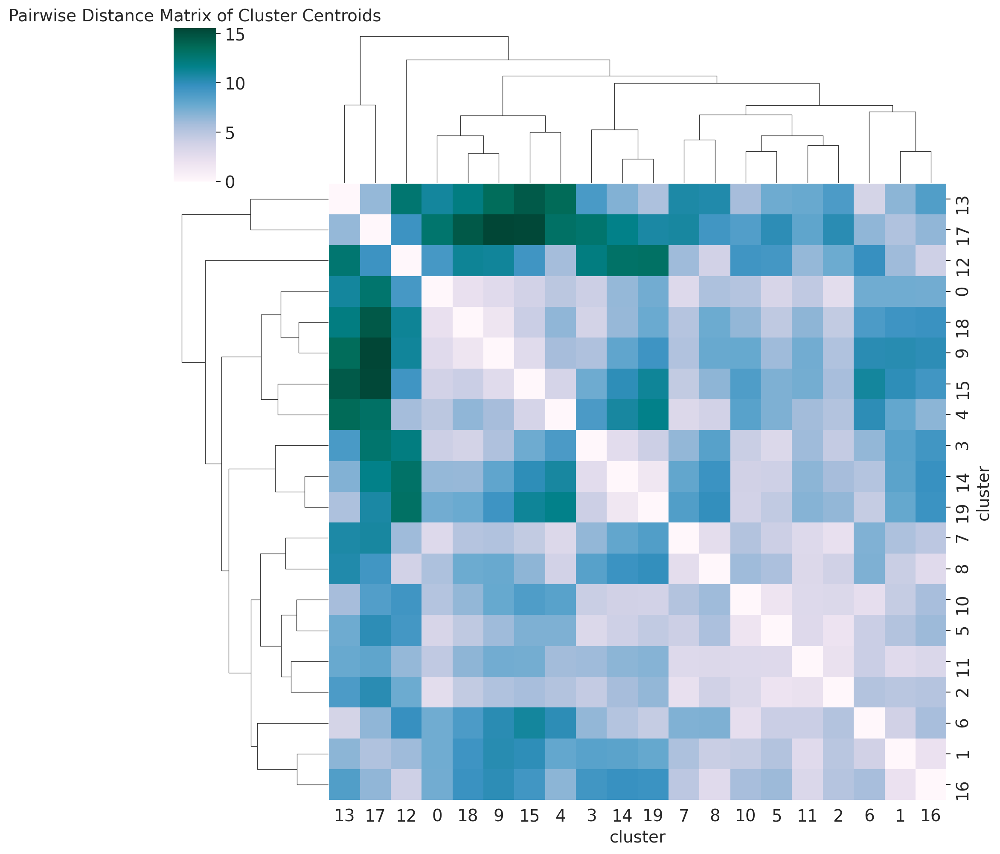

In [ ]:
mde_padj5 = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=5, mde_repulsive_fraction=10, knn_n_neighbors=7,
                        leiden_resolution=0.15)

In [ ]:
_, _, _, _, embedding_df = mde_padj5
perts_in_cluster = gene_targets_per_cluster(embedding_df)
perts_in_cluster.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,AHR,ARID2,ARNT2,BBX,BHLHE22,ARX,ALX4,ANKZF1,ATF6B,BSX,ASCL5,BACH1,ADNP2,ARID3B,CBX2,ESR1,CREBZF,HNF4A,NR4A2,ATF3
1,ASCL1,BARHL1,ATF1,BHLHA15,DLX2,BHLHA9,ATOH8,DEAF1,CENPB,CAMTA2,BHLHE40,E2F2,ARHGAP35,GLI2,CDX1,FOXD1,HES6,PHF20,POU4F1,ATF4
2,ATOH7,CREB3L4,ATOH1,DLX1,DMRTC2,CREB1,BAZ2A,DMRTA1,CENPT,DMRT1,CC2D1A,FOXL2,ATMIN,HEY2,DACH2,GRHL2,HESX1,POU3F2,STAT5A,BARX1
3,BCL6B,CREBL2,BATF,DUXA,E2F1,CREB3L1,E2F7,EMX1,DMRT3,EN1,ERG,GATAD2B,CHAMP1,HMX3,FOXG1,PCGF6,KLF12,POU5F1,TET1,HDX
4,CENPX,DLX4,BCL11A,EGR1,EBF3,CREB3L3,ETS1,FOSL2,ELF4,EPAS1,ESRRB,GRHL3,DNMT1,KLF1,FOXM1,SOX3,NKX3-1,POU5F1B,TPRX1,PGR


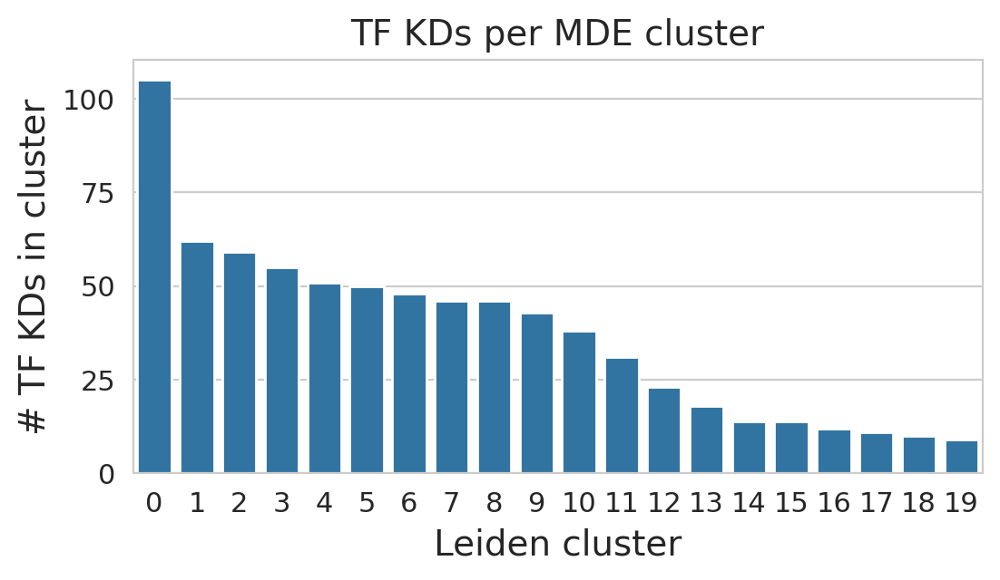

In [ ]:
plot_n_perts_per_cluster(perts_in_cluster, title="TF KDs per MDE cluster")

Dec 12 09:12:22 AM: Fitting a centered embedding into R^2, for a graph with 726 items and 33656 edges.
Dec 12 09:12:22 AM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 12 09:12:22 AM: iteration 0000 | distortion 2.804580 | residual norm 1.87417 | step length 0.0183307 | percent change 0.0901583
Dec 12 09:12:23 AM: iteration 0100 | distortion 0.143501 | residual norm 0.0003732 | step length 1 | percent change 1.42743
Dec 12 09:12:24 AM: iteration 0200 | distortion 0.140036 | residual norm 0.000271371 | step length 1 | percent change 0.776039
Dec 12 09:12:25 AM: iteration 0300 | distortion 0.137874 | residual norm 0.000143677 | step length 1 | percent change 0.301216
Dec 12 09:12:26 AM: iteration 0400 | distortion 0.137429 | residual norm 6.63758e-05 | step length 1 | percent change 0.0603065
Dec 12 09:12:27 AM: iteration 0500 | distortion 0.137356 | residual norm 4.94569e-05 | step length 1 | percent change 0.0490207
Dec 12 09:12:28 AM: iteration 0600 | dist

Dec 12 09:12:49 AM: iteration 1600 | distortion 0.136576 | residual norm 1.34623e-05 | step length 0 | percent change 0
Dec 12 09:12:54 AM: iteration 1700 | distortion 0.136576 | residual norm 1.34623e-05 | step length 0 | percent change 0
Dec 12 09:13:00 AM: iteration 1800 | distortion 0.136576 | residual norm 1.34623e-05 | step length 0 | percent change 0
Dec 12 09:13:06 AM: iteration 1900 | distortion 0.136576 | residual norm 1.34623e-05 | step length 0 | percent change 0
Dec 12 09:13:11 AM: iteration 1999 | distortion 0.136576 | residual norm 1.34623e-05 | step length 0 | percent change 0
Dec 12 09:13:11 AM: Finished fitting in 49.525 seconds and 2000 iterations.
Dec 12 09:13:11 AM: average distortion 0.137 | residual norm 1.3e-05


/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



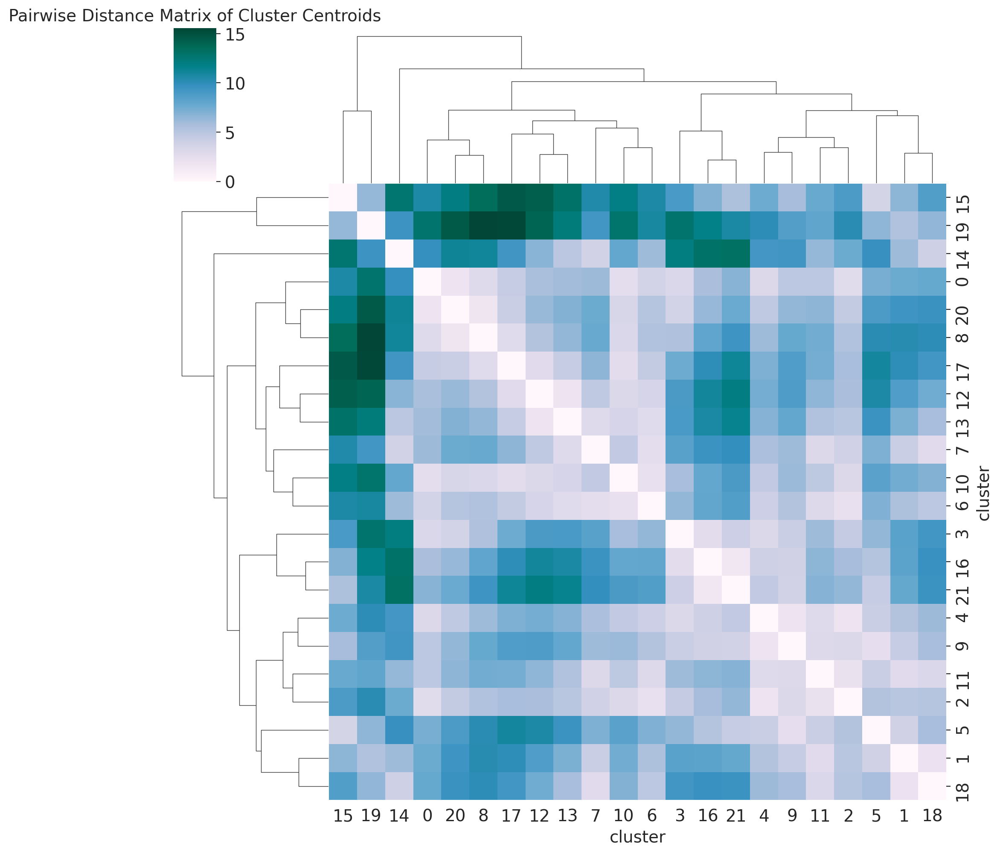

In [ ]:
mde_padj5_res0pt2 = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=5, mde_repulsive_fraction=10, knn_n_neighbors=7,
                        leiden_resolution=0.2)

In [ ]:
adata02, embedding02, clusters02, mean_profiles_arr02, embedding_df02, pairwise_dists02 = mde_padj5_res0pt2

In [ ]:
silh_score02 = compute_silhouette_score(embedding02, clusters02)
print(silh_score02)

0.30973417


In [ ]:
mean_dist02, median_dist02 = \
    compute_mean_median_pairwise_centroid_distance(pairwise_dists02)

Mean pairwise cluster centroid distance: 6.844214228490154
Median pairwise cluster centroid distance: 6.41780980553878


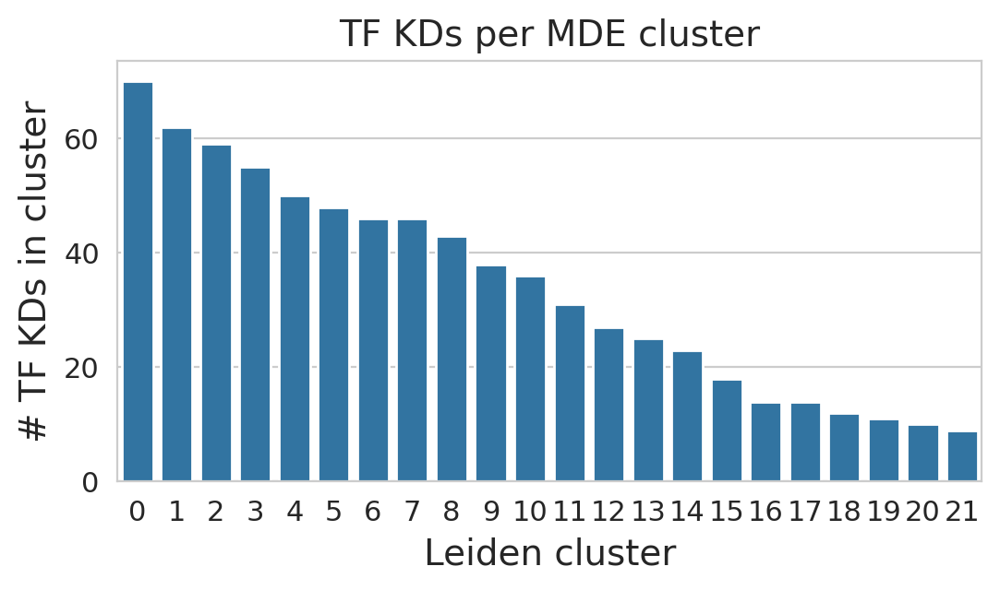

In [ ]:
perts_in_cluster02 = gene_targets_per_cluster(embedding_df02)
plot_n_perts_per_cluster(perts_in_cluster02, title="TF KDs per MDE cluster")

Try 11 neighbors for KNN graph

Dec 08 11:16:25 PM: Fitting a centered embedding into R^2, for a graph with 726 items and 47020 edges.
Dec 08 11:16:25 PM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 08 11:16:25 PM: iteration 0000 | distortion 2.193861 | residual norm 0.724971 | step length 0.0461945 | percent change 0.0878875


Dec 08 11:16:26 PM: iteration 0100 | distortion 0.157413 | residual norm 0.000282532 | step length 1 | percent change 0.42995
Dec 08 11:16:27 PM: iteration 0200 | distortion 0.154090 | residual norm 0.000125286 | step length 1 | percent change 0.0848489
Dec 08 11:16:29 PM: iteration 0300 | distortion 0.153317 | residual norm 0.000132018 | step length 1 | percent change 0.271556
Dec 08 11:16:30 PM: iteration 0400 | distortion 0.152364 | residual norm 7.52222e-05 | step length 1 | percent change 0.160824
Dec 08 11:16:31 PM: iteration 0500 | distortion 0.152028 | residual norm 5.99528e-05 | step length 1 | percent change 0.238899
Dec 08 11:16:33 PM: iteration 0600 | distortion 0.151518 | residual norm 4.32662e-05 | step length 1 | percent change 0.0518756
Dec 08 11:16:34 PM: iteration 0700 | distortion 0.151442 | residual norm 2.82465e-05 | step length 1 | percent change 0.0176673
Dec 08 11:16:36 PM: iteration 0800 | distortion 0.151421 | residual norm 5.62446e-05 | step length 1 | percen

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



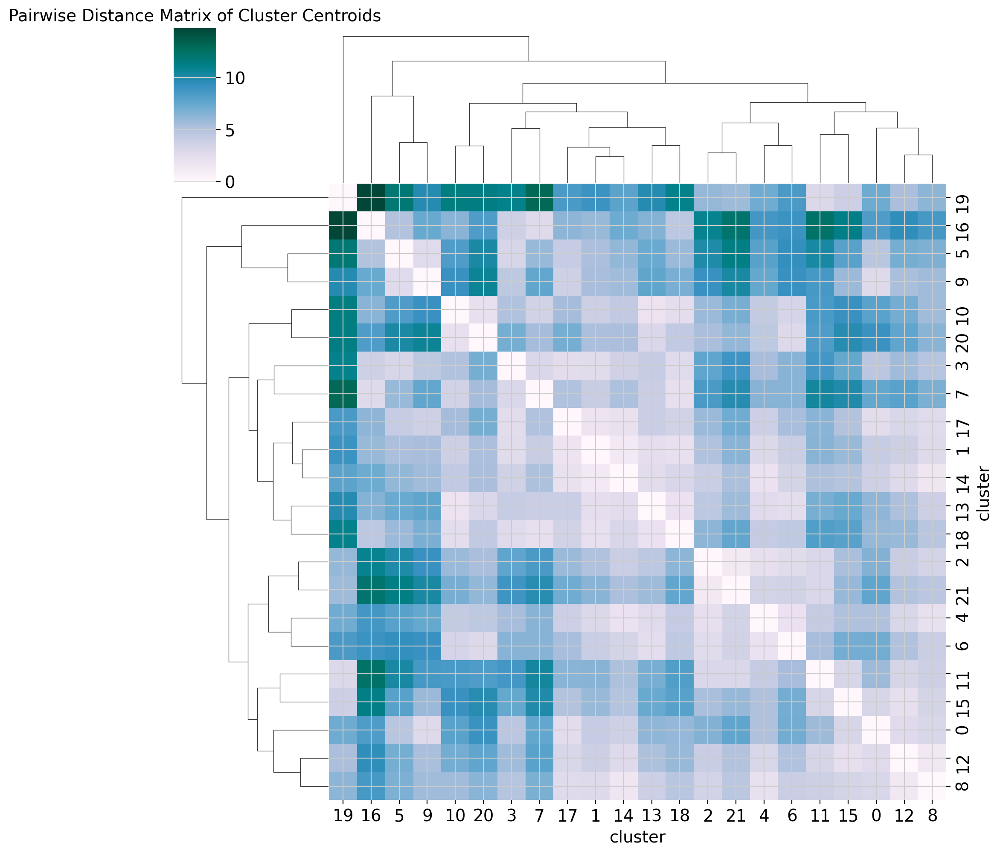

In [ ]:
sns.set_style("white")
mde_padj5 = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=7, mde_repulsive_fraction=10, knn_n_neighbors=11)

Try higher number for mde_repulsive_fraction

Dec 08 11:17:34 PM: Fitting a centered embedding into R^2, for a graph with 726 items and 68371 edges.
Dec 08 11:17:34 PM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Dec 08 11:17:34 PM: iteration 0000 | distortion 2.257379 | residual norm 0.722403 | step length 0.0459016 | percent change 0.087021
Dec 08 11:17:36 PM: iteration 0100 | distortion 0.122615 | residual norm 0.000257932 | step length 1 | percent change 0.493292
Dec 08 11:17:38 PM: iteration 0200 | distortion 0.119705 | residual norm 0.000125772 | step length 1 | percent change 0.149569
Dec 08 11:17:40 PM: iteration 0300 | distortion 0.118188 | residual norm 8.78487e-05 | step length 1 | percent change 0.164904
Dec 08 11:17:42 PM: iteration 0400 | distortion 0.117509 | residual norm 8.73387e-05 | step length 1 | percent change 0.270797
Dec 08 11:17:44 PM: iteration 0500 | distortion 0.116905 | residual norm 9.11122e-05 | step length 1 | percent change 0.189204
Dec 08 11:17:45 PM: iteration 0600 | dis

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/home/ranwyl/psp_env/lib64/python3.11/site-packages/seaborn/matrix.py:530: ClusterWarning:

The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



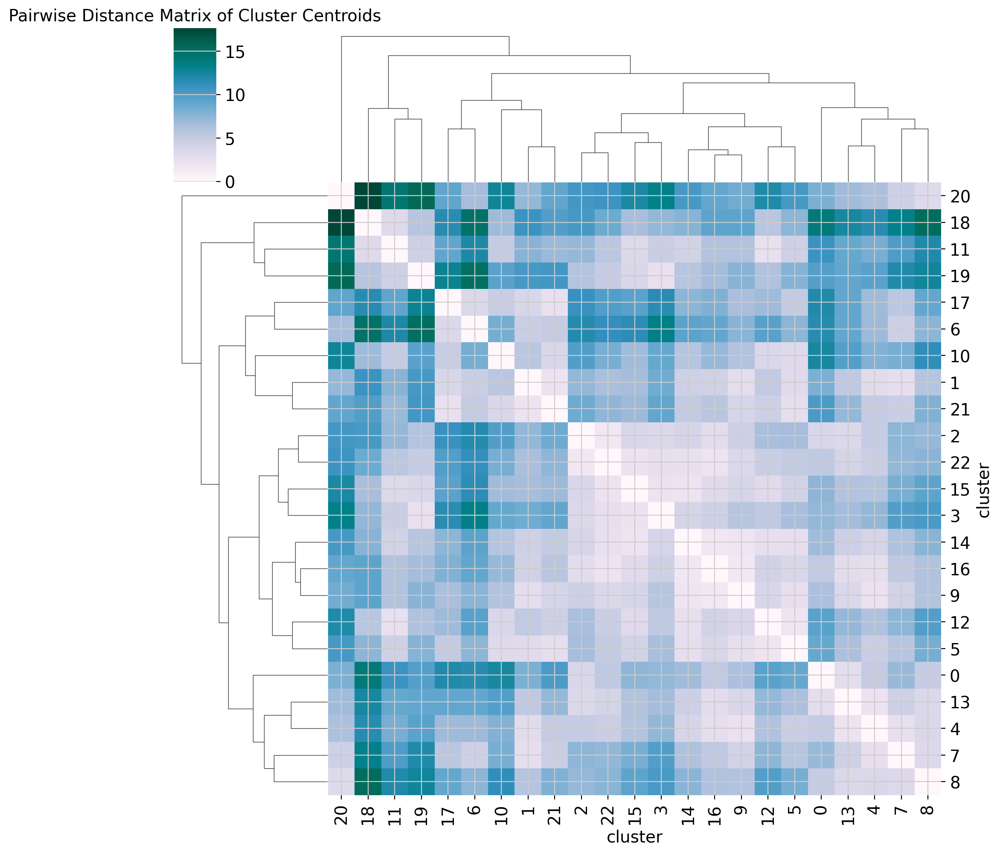

In [ ]:
mde_padj5 = compute_MDE(adata_padj5_lfc0pt25, n_components=20, spectral_n_neighbors=25,
                        mde_n_neighbors=7, mde_repulsive_fraction=15, knn_n_neighbors=11)